In [4]:
import numpy as np
import pandas as pd
from pathlib import Path
from skimage.io import imread
from skimage.io import imsave
from scipy.spatial import KDTree
from cell_segmentation_adaptive import segment_cell_adaptive
from draw_spots import crop_df
BASE_DIR = Path('/mnt/data/local_processed_data')
RUN_ID = '20220106_Normal2_redo_overnight'
src_dir = BASE_DIR / f'{RUN_ID}_processed'
stc_dir = src_dir / 'stitched'
read_dir = src_dir / 'readout'
seg_dir = src_dir / 'segmented'
visual_dir = src_dir / 'visualization'
visual_dir.mkdir(exist_ok=True)

In [ ]:
centroids = pd.read_csv(seg_dir/'centroids_all.csv').to_numpy()

In [ ]:
rna_df = pd.read_csv(read_dir/'mapped_genes.csv')
rna_pos = rna_df[['Y', 'X']].to_numpy()
tree = KDTree(centroids)
distances, indices = tree.query(rna_pos, k=1, distance_upper_bound=100)
rna_df['Cell Index'] = indices
rna_df = rna_df[rna_df['Cell Index'] < centroids.shape[0]]
rna_df.to_csv(visual_dir/'rna_labeled.csv',index=False)
rna_df

In [ ]:
match_df = rna_df.copy()
match_df['Count'] = np.ones(len(match_df))
match_df_group = match_df[['Cell Index','Gene','Count']].groupby(['Cell Index','Gene']).count()
matrix = match_df_group.unstack().fillna(0)
matrix.columns = matrix.columns.droplevel()
matrix.columns.name = None
matrix.index.name = None
matrix.to_csv(visual_dir/'expression_matrix.csv')
matrix

In [ ]:
matrix[matrix < 2] = 0
matrix[matrix > 1] = matrix - 1
matrix

In [ ]:
matrix[['Actb']] *=5
matrix[['Slc17a7']] *=2
matrix[['Sst']] *=10
matrix[['Snap25']] *=3
matrix[['Cst3']] *=3
matrix[['Mbp']] *=3
matrix[['Penk']] *=4
matrix

In [ ]:
matrix = matrix[[s for s in matrix.columns if s in ['Snap25','Lamp5','Slc17a7','Plp1','Gad1','Cck','Gad2','Pvalb','Sst','Vip','Lhx6','Npy','Gfap','Mbp','Olig1','Pcp4','Rasgrf2','Cux2','Rorb','Rprm','Ctgf','Itgam','Reln']]]
matrix.to_csv(visual_dir/'expression_matrix.csv')
matrix

In [ ]:
# merge exoression matrix from AD and Normal
matrix = pd.read_csv(visual_dir/'expression_matrix.csv')
matrix = matrix.drop(columns='Unnamed: 0')
matrix
# matrix = matrix.reset_index()

In [ ]:
test = pd.read_csv(visual_dir/'test.csv')
test = test[[s for s in test.columns if s in ['Snap25','Slc17a7','Rasgrf2','Rorb','Pcp4','Rprm','Ctgf','Gad2','Reln','Sst','Vip','Lhx6','Npy','Lamp5','Gfap','S100b','Aqp4','Cx3cr1','Plp1','Mbp']]]
test = test[[s for s in test.rows if s in ['1']]]
test

In [ ]:
import os
os.system(f'python /mnt/data/processing_codes/STARmap/python/examples/cluster.py {RUN_ID}')

In [ ]:
cluster_df = pd.read_csv(visual_dir/'STARmap_clusters.csv')
cluster_df.set_index('Cell Index', inplace=True)
cluster_df.index.name = None
select_matrix = matrix.merge(cluster_df, right_index=True, left_index=True)
select_matrix

In [ ]:
normalized = pd.read_csv(visual_dir/'STARmap_normalized.csv')
normalized.index = select_matrix.index
normalized

In [ ]:
for row in ['Cluster','UMAP-1','UMAP-2']:
    normalized[row] = select_matrix[row]
normalized

In [ ]:
# see how many PCs should be used
from sklearn.decomposition import PCA
X = np.array(matrix)
pca = PCA(n_components=12)
newX = pca.fit_transform(X)
print(pca.explained_variance_ratio_)

In [ ]:
gene_names = [s for s in normalized.columns if s not in ['Cluster','Count','UMAP-1','UMAP-2','Actb','Penk','App_human','Mog','Adarb2']]
normalized_group = normalized.groupby('Cluster').mean()
normalized_group['Count'] = normalized.groupby('Cluster').count()['Plp1']
#normalized_group[['Olig1']] /= 2
#normalized_group[['Apoe']] /= 2
normalized_group[['Gad1','Gad2','Pcp4','Pvalb','Sst']] /=2
normalized_group[gene_names+['Count']]
normalized_group

In [ ]:
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
matplotlib.rcParams.update({
    "pgf.texsystem": "xelatex",
    'font.family': 'serif',
    'text.usetex': False,
    'pgf.rcfonts': False,
    'figure.dpi': 300,
})
fig = plt.figure(figsize=(40,10),dpi=300)
sns.heatmap(normalized_group[gene_names],cmap='viridis')
plt.savefig(visual_dir/'expression_heatmap_marker_Inhibit_v1.pdf')
plt.show()

In [ ]:
select_matrix = pd.read_csv(visual_dir/'pc_umap_cluster.csv')
select_matrix

In [ ]:
plt.style.use('default')

In [ ]:
import matplotlib.pyplot as plt
fig,ax = plt.subplots(figsize=(8,6))
sns.scatterplot(data=select_matrix, x='UMAP-1', y='UMAP-2', hue='Cluster', palette=plt.cm.get_cmap('nipy_spectral',len(np.unique(select_matrix['Cluster']))), s=5, legend='full')
plt.savefig(visual_dir/'umap_scatter_whole_brain_marker_Inhibit_v1.pdf')
plt.show()

In [ ]:
# custom type dict according to heatmap
type_dict = {
    0: 'Glia',
    1: 'Glia',
    2: 'Excite',
    3: 'Inhibit',
    4: 'Excite',
    5: 'Excite',
    6: 'Excite',
    7: 'Glia',
    8: 'Glia',
    9: 'Excite',
    10: 'Excite',
    11: 'Excite',
    12: 'Glia',
    13: 'Glia',
    14: 'Glia'
}
factor_dict = {
    'Glia': 3,
    'Excite': 2,
    'Inhibit': 1
}
normalized['Type'] = normalized['Cluster'].map(type_dict)
normalized['Type Factor'] = normalized['Type'].map(factor_dict)
select_matrix['Type'] = select_matrix['Cluster'].map(type_dict)
select_matrix['Type Factor'] = select_matrix['Type'].map(factor_dict)
normalized

In [ ]:
fig,ax = plt.subplots(figsize=(8,6))
sns.scatterplot(data=select_matrix, x='UMAP-1', y='UMAP-2', hue='Type Factor', palette=plt.cm.get_cmap('jet',len(np.unique(select_matrix['Cluster']))), s=5, legend='full')
plt.savefig(visual_dir/'umap_scatter_0316combined.pdf')
plt.show()

In [ ]:
select_matrix.to_csv(visual_dir/'select_matrix.csv')

In [ ]:
select_matrix = pd.read_csv(visual_dir/'select_matrix.csv')

In [ ]:
matrix_1 = pd.read_csv(visual_dir/'expression_matrix_1.csv')
matrix_1

In [ ]:
for idx in range(0,len(select_matrix)):
    select_matrix['Cell_Index'][idx] = matrix_1['Cell_Index'][select_matrix['num'][idx]]
select_matrix.to_csv(visual_dir/'select_matrix.csv')
select_matrix

In [ ]:
matrix_normalized = pd.read_csv(visual_dir/'expression_matrix_normalized.csv')
All_typed = pd.read_csv(visual_dir/'select_matrix_All_typed(17).csv')

In [ ]:
type = 16
for idx in list(All_typed[All_typed['Type Factor']==type]['Cell_Index']):
    matrix_normalized.loc[matrix_normalized['Cell_Index'] == idx,'Type'] = type

In [ ]:
matrix_normalized.to_csv(visual_dir/'test.csv')

In [ ]:
matrix_normalized

In [ ]:
for idx in range(0,len(matrix_normalized)):
    matrix_normalized['Type'][matrix_normalized['Cell_Index'] == idx]

In [36]:
factor = pd.read_csv(visual_dir/'select_matrix_All_typed(17).csv')
type_indices = {}
for type in range(len(np.unique(factor['Cluster']))):
    type_indices[type] = list(factor[factor['Cluster']==type]['Cell_Index'])

KeyError: 'Cluster'

In [ ]:
cell_pos['Type'] = normalized['Type Factor']
cell_pos_select = cell_pos[cell_pos['Type']>0]
cell_pos_select['Type'] = cell_pos_select['Type'].astype(int)
cell_pos_select.to_csv(visual_dir/'cell_position_select.csv')

In [ ]:
centroids = cell_pos_select[['Y','X']].to_numpy()
factors = cell_pos_select['Type']
factors.index = segmented[centroids[:,0],centroids[:,1]]
factor_dict = factors.to_dict()
def replace_with_dict_generic(ar, dic, assume_all_present=True):
    # Extract out keys and values
    k = np.array(list(dic.keys()))
    v = np.array(list(dic.values()))

    # Get argsort indices
    sidx = k.argsort()

    ks = k[sidx]
    vs = v[sidx]
    idx = np.searchsorted(ks,ar)

    if not assume_all_present:
        idx[idx==len(vs)] = 0
        mask = ks[idx] == ar
        return np.where(mask, vs[idx], ar)
    else:
        return vs[idx]

im_factor = (replace_with_dict_generic(segmented,factor_dict,assume_all_present=False))
im_factor[im_factor>5] = 6

In [ ]:
import matplotlib.patches as mpatches
from matplotlib.colors import ListedColormap

data = im_factor.copy()
values = np.unique(data.ravel())
#cmap = ListedColormap(['white','crimson','Green','khaki','lightskyblue','gray','lightgray'])
#labels = ['Background','Excite','Inhibit','Astro','Micro','Oligo','Other']
cmap = ListedColormap(['white','Red','Green','Blue','Cyan','midnightblue','lightgray'])
labels = ['Background','Excite','Inhibit','Micro','Astro','Oligo','Other']
plt.figure(figsize=(8,4))
im = plt.imshow(data, interpolation='none',cmap=cmap)
colors = [im.cmap(im.norm(value)) for value in values]
patches = [ mpatches.Patch(color=colors[i], label=labels[i] ) for i in range(len(values)) ]
plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0. )
plt.axis('off')
plt.savefig(visual_dir/'cell_types_remap_5types.pdf', bbox_inches='tight')
plt.show()

In [67]:
factor = pd.read_csv(visual_dir/'select_matrix_v0.5.csv')
type_indices = {}
for type in range(len(np.unique(factor['Cluster']))):
    type_indices[type] = list(factor[factor['Cluster']==type]['Cell_Index'])
factor

,Unnamed: 0,Ctgf,Cux2,Cx3cr1,Gad1,Gad2,Gfap,Itgam,Lhx6,Mbp,...,Rasgrf2,Rorb,Rprm,Slc17a7,Snap25,Vip,Cluster,UMAP-1,UMAP-2,Cell_Index
0,0,0,2,0,0,0,0,0,1,0,...,0,0,0,5,0,0,0,7.557351,8.144874,25
1,1,0,0,0,0,0,1,0,0,2,...,0,0,0,3,0,0,0,8.358618,7.031101,101
2,2,0,0,0,0,1,2,0,0,0,...,0,0,0,1,0,0,0,11.983647,7.561932,121
3,3,0,0,0,2,2,0,0,0,6,...,0,0,0,1,0,0,0,7.908951,6.721659,200
4,4,0,0,1,3,2,0,0,0,0,...,0,1,0,1,0,0,0,8.618006,7.509133,206
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33961,33961,0,1,0,1,0,0,0,0,0,...,0,0,0,4,5,0,10,14.157940,7.164442,139823
33962,33962,0,0,0,0,0,0,0,1,0,...,0,0,0,6,3,0,10,14.266154,7.118642,140653
33963,33963,0,0,0,0,0,0,0,0,0,...,0,0,0,2,2,0,10,15.155067,6.996159,141528
33964,33964,0,0,0,0,0,0,0,0,0,...,1,0,0,7,1,0,10,14.589582,6.947846,142458


In [ ]:
float(factor[factor['Cell_Index']==21]['Slc17a7_nor'])

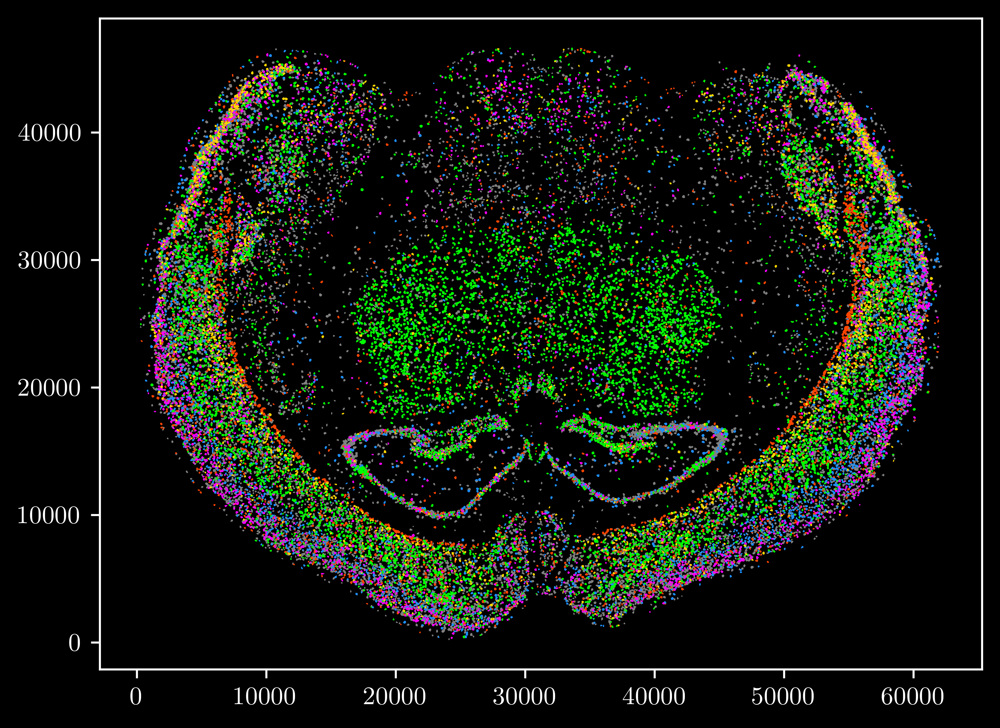

In [73]:
#Glia parameter
from scipy.spatial import ConvexHull
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
plt.style.use('dark_background')
from matplotlib.colors import ListedColormap
from scipy.interpolate import splprep
from scipy.interpolate import splev
from scipy.spatial.qhull import QhullError
matplotlib.rcParams.update({
"pgf.texsystem": "xelatex",
'font.family': 'serif',
'text.usetex': True,
'pgf.rcfonts': False,
'figure.dpi': 600,
})
x = 1
df = pd.read_csv(visual_dir/'rna_labeled.csv')
hulls = {}
df_group = df.groupby('Cell Index')
for group in df_group:
    coordinates = group[1][['Y', 'X']].values   
    try:
        hull = ConvexHull(coordinates)
        coordinate_path = np.vstack((coordinates[hull.vertices,0], coordinates[hull.vertices,1])).T
        hulls[group[0]] = coordinate_path
    except QhullError:
        pass
#fig = plt.figure(figsize=(6,4))
fig,ax = plt.subplots(figsize=(6.2,4.7))
#for idx in hulls:
  #  ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "lightgray", linewidth=0.5)
for idx in type_indices[0]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[3]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[4]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[5]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[6]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[12]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[13]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[2]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "orangered", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[8]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "dodgerblue", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[9]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "lime", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[10]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "lime", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[11]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "lime", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[1]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "magenta", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[7]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gold", linewidth=0.3, alpha=x)
    except KeyError:
        pass
#for idx in type_indices[9]:
 #   try:
  #      ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "green", linewidth=0.3)
   # except KeyError:
    #    pass
#for idx in type_indices[3]:
 #   try:
  #      ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.5)
   # except KeyError:
    #    pass
#for idx in list(type_indices[5]):
 #   ax.fill(hulls[idx][:,0], hulls[idx][:,1], color = "blue", linewidth=0.5)
#for idx in type_indices[3]:
 #   plt.fill(hulls[idx][:,0], hulls[idx][:,1], color = "blue", linewidth=0.5)
#for idx in type_indices[4]:
 #   plt.fill(hulls[idx][:,0], hulls[idx][:,1], color = "yellow", linewidth=0.5)
#for idx in type_indices[5]:
 #   plt.fill(hulls[idx][:,0], hulls[idx][:,1], color = "red", linewidth=0.5)
#for idx in type_indices[6]:
 #   plt.fill(hulls[idx][:,0], hulls[idx][:,1], color = "lime", linewidth=0.5)
plt.savefig(visual_dir/'rna_hulls_whole_brain_Excite_4_7.pdf')
#plt.show()

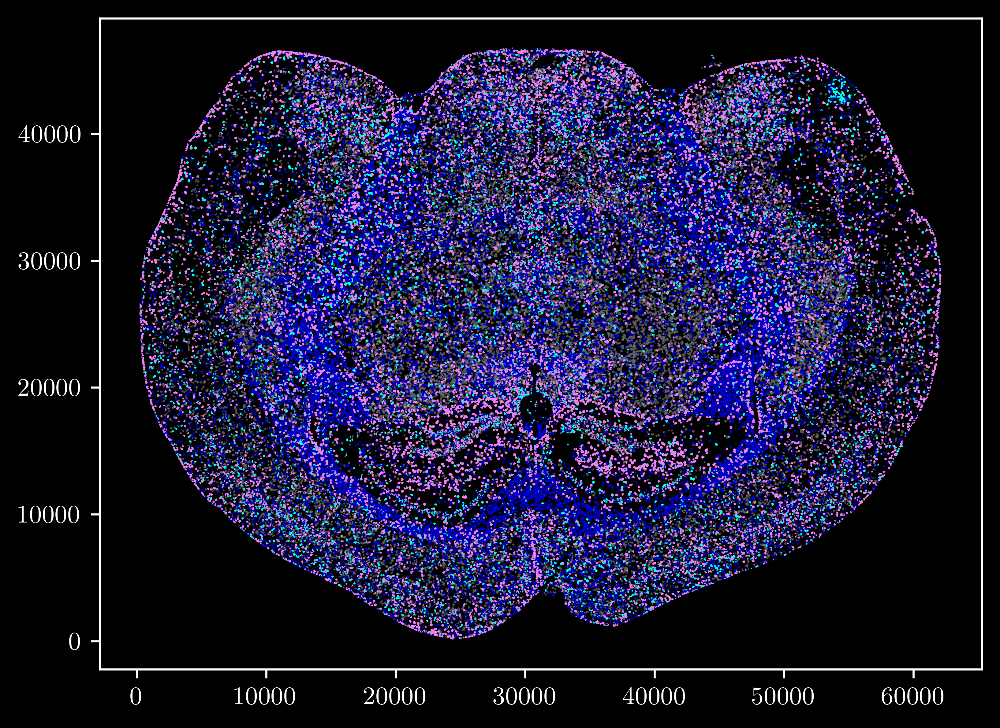

In [33]:
#Glia parameter
from scipy.spatial import ConvexHull
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import ListedColormap
from scipy.interpolate import splprep
from scipy.interpolate import splev
from scipy.spatial.qhull import QhullError
matplotlib.rcParams.update({
"pgf.texsystem": "xelatex",
'font.family': 'serif',
'text.usetex': True,
'pgf.rcfonts': False,
'figure.dpi': 600,
})
df = pd.read_csv(visual_dir/'rna_labeled.csv')
hulls = {}
df_group = df.groupby('Cell Index')
for group in df_group:
    coordinates = group[1][['Y', 'X']].values   
    try:
        hull = ConvexHull(coordinates)
        coordinate_path = np.vstack((coordinates[hull.vertices,0], coordinates[hull.vertices,1])).T
        hulls[group[0]] = coordinate_path
    except QhullError:
        pass
#fig = plt.figure(figsize=(6,4))
fig,ax = plt.subplots(figsize=(6.2,4.7))
#for idx in hulls:
  #  ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "lightgray", linewidth=0.5)
for idx in type_indices[0]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.3, alpha=0.5)
    except KeyError:
        pass
for idx in type_indices[8]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.3, alpha=0.5)
    except KeyError:
        pass
for idx in type_indices[4]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "cyan", linewidth=0.3, alpha=1)
    except KeyError:
        pass
for idx in type_indices[3]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "mediumblue", linewidth=0.3, alpha=1)
    except KeyError:
        pass
for idx in type_indices[1]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "mediumblue", linewidth=0.3, alpha=1)
    except KeyError:
        pass
for idx in type_indices[6]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "mediumblue", linewidth=0.3, alpha=1)
    except KeyError:
        pass
for idx in type_indices[7]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "mediumblue", linewidth=0.3, alpha=1)
    except KeyError:
        pass
for idx in type_indices[2]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "violet", linewidth=0.3, alpha=1)
    except KeyError:
        pass
for idx in type_indices[5]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "violet", linewidth=0.3, alpha=1)
    except KeyError:
        pass
#for idx in type_indices[9]:
 #   try:
  #      ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "green", linewidth=0.3)
   # except KeyError:
    #    pass
#for idx in type_indices[3]:
 #   try:
  #      ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.5)
   # except KeyError:
    #    pass
#for idx in list(type_indices[5]):
 #   ax.fill(hulls[idx][:,0], hulls[idx][:,1], color = "blue", linewidth=0.5)
#for idx in type_indices[3]:
 #   plt.fill(hulls[idx][:,0], hulls[idx][:,1], color = "blue", linewidth=0.5)
#for idx in type_indices[4]:
 #   plt.fill(hulls[idx][:,0], hulls[idx][:,1], color = "yellow", linewidth=0.5)
#for idx in type_indices[5]:
 #   plt.fill(hulls[idx][:,0], hulls[idx][:,1], color = "red", linewidth=0.5)
#for idx in type_indices[6]:
 #   plt.fill(hulls[idx][:,0], hulls[idx][:,1], color = "lime", linewidth=0.5)
plt.savefig(visual_dir/'rna_hulls_whole_brain_glia_4_4.pdf')
plt.show()

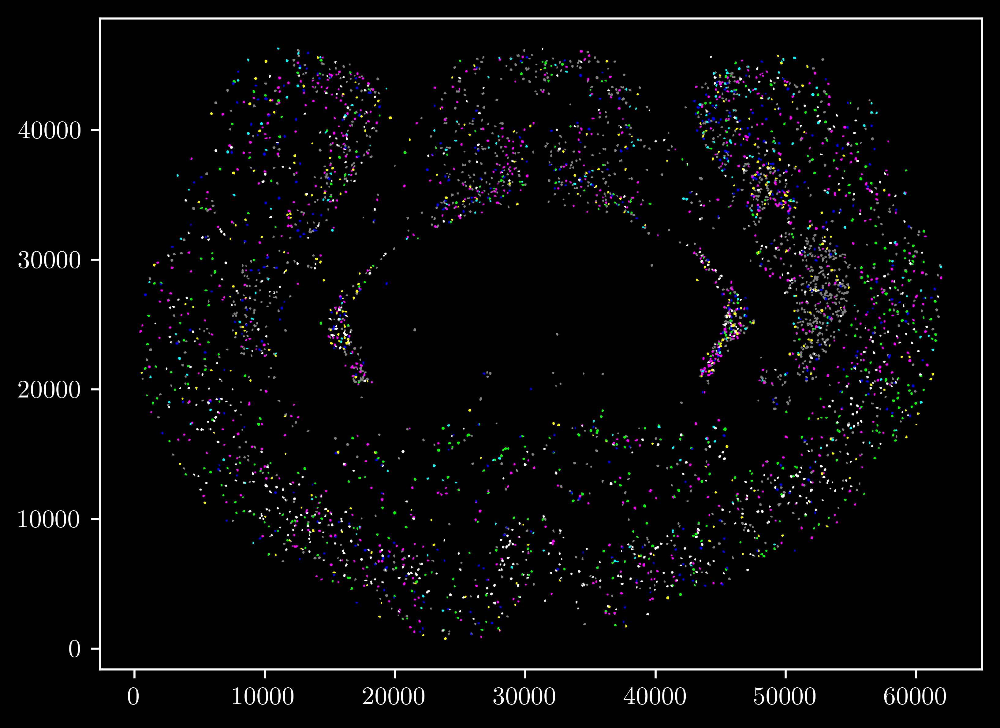

In [26]:
#Inhibitory neuron parameter
from scipy.spatial import ConvexHull
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
plt.style.use('dark_background')
from matplotlib.colors import ListedColormap
from scipy.interpolate import splprep
from scipy.interpolate import splev
from scipy.spatial.qhull import QhullError
matplotlib.rcParams.update({
"pgf.texsystem": "xelatex",
'font.family': 'serif',
'text.usetex': True,
'pgf.rcfonts': False,
'figure.dpi': 600,
})
df = pd.read_csv(visual_dir/'rna_labeled.csv')
hulls = {}
df_group = df.groupby('Cell Index')
for group in df_group:
    coordinates = group[1][['Y', 'X']].values   
    try:
        hull = ConvexHull(coordinates)
        coordinate_path = np.vstack((coordinates[hull.vertices,0], coordinates[hull.vertices,1])).T
        hulls[group[0]] = coordinate_path
    except QhullError:
        pass
#fig = plt.figure(figsize=(6,4))
fig,ax = plt.subplots(figsize=(6.2,4.7))
#for idx in hulls:
  #  ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "lightgray", linewidth=0.5)
for idx in type_indices[1]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.3, alpha=1)
    except KeyError:
        pass
for idx in type_indices[4]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.3, alpha=1)
    except KeyError:
        pass
for idx in type_indices[7]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.3, alpha=1)
    except KeyError:
        pass
for idx in type_indices[9]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.3, alpha=1)
    except KeyError:
        pass
for idx in type_indices[5]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "magenta", linewidth=0.3, alpha=1)
    except KeyError:
        pass
for idx in type_indices[1]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "lime", linewidth=0.3, alpha=1)
    except KeyError:
        pass
for idx in type_indices[8]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "yellow", linewidth=0.3, alpha=1)
    except KeyError:
        pass
for idx in type_indices[3]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "cyan", linewidth=0.3, alpha=1)
    except KeyError:
        pass
for idx in type_indices[2]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "white", linewidth=0.3, alpha=1)
    except KeyError:
        pass
for idx in type_indices[6]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "blue", linewidth=0.3, alpha=1)
    except KeyError:
        pass
#for idx in type_indices[9]:
 #   try:
  #      ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "green", linewidth=0.3)
   # except KeyError:
    #    pass
#for idx in type_indices[3]:
 #   try:
  #      ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gray", linewidth=0.5)
   # except KeyError:
    #    passwei
#for idx in list(type_indices[5]):
 #   ax.fill(hulls[idx][:,0], hulls[idx][:,1], color = "blue", linewidth=0.5)
#for idx in type_indices[3]:_0.5
 #   plt.fill(hulls[idx][:,0], hulls[idx][:,1], color = "blue", linewidth=0.5)
#for idx in type_indices[4]:
 #   plt.fill(hulls[idx][:,0], hulls[idx][:,1], color = "yellow", linewidth=0.5)
#for idx in type_indices[5]:
 #   plt.fill(hulls[idx][:,0], hulls[idx][:,1], color = "red", linewidth=0.5)
#for idx in type_indices[6]:
 #   plt.fill(hulls[idx][:,0], hulls[idx][:,1], color = "lime", linewidth=0.5)
plt.savefig(visual_dir/'rna_hulls_whole_brain_Inhibitory_4_4.pdf')
plt.show()


In [24]:
matrix_3 = pd.read_csv(visual_dir/'select_matrix_Inhibit.csv')
matrix_3 = matrix_3.drop(columns='Unnamed: 0')
matrix_3

,Cck,Ctgf,Cux2,Gad1,Gad2,Gfap,Itgam,Lamp5,Lhx6,Mbp,...,Rorb,Rprm,Slc17a7,Snap25,Sst,Vip,Cluster,UMAP-1,UMAP-2,Cell_Index
0,0,3,0,9,6,0,0,0,3,0,...,2,1,12,1,10,0,0,2.717943,3.967423,174
1,0,4,0,2,10,1,0,0,1,2,...,0,0,2,13,0,0,0,3.753154,3.851639,331
2,0,2,0,4,4,1,0,0,0,2,...,0,0,0,1,0,0,0,3.675804,2.879236,704
3,0,1,0,3,3,1,0,0,1,0,...,0,0,4,1,0,1,0,3.837754,6.817364,1039
4,0,1,0,4,6,2,0,2,2,3,...,1,0,0,2,10,0,0,2.444200,3.894086,1285
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4856,0,0,0,1,5,0,0,0,0,2,...,1,0,0,0,0,0,9,4.780106,1.766770,144647
4857,0,0,0,0,7,0,0,0,0,2,...,0,0,0,0,0,0,9,5.738625,1.143216,144765
4858,0,3,0,6,9,0,0,0,0,8,...,0,0,2,2,110,0,9,3.977162,1.330952,145337
4859,0,0,0,4,18,2,0,0,0,10,...,1,0,0,6,0,0,9,5.351097,1.645642,145469


In [ ]:
# custom type dict according to heatmap
type_dict = {
    0: 'Inhibit_Other',
    1: 'Inhibit_Npy',
    2: 'Inhibit_Lhx6',
    3: 'Inhibit_Reln',
    4: 'Inhibit_Other',
    5: 'Inhibit_Sst',
    6: 'Inhibit_Vip',
    7: 'Inhibit_Other',
    8: 'Inhibit_Lamp5',
    9: 'Inhibit_Other',
}
factor_dict = {
    'Inhibit_Reln': 7,
    'Inhibit_Sst': 8,
    'Inhibit_Vip': 9,
    'Inhibit_Lhx6': 10,
    'Inhibit_Npy': 11,
    'Inhibit_Lamp5': 12,
    'Inhibit_Other': 13,
}
matrix_3['Type'] = matrix_3['Cluster'].map(type_dict)
matrix_3['Type Factor'] = matrix_3['Type'].map(factor_dict)
matrix_3.to_csv(visual_dir/'select_matrix_Inhibit_typed(16).csv')
matrix_3

In [34]:
factor = pd.read_csv(visual_dir/'expression_matrix_marker_all.csv')
type_indices = {}
for type in range(1,len(np.unique(factor['Type']))+1):
    type_indices[type] = list(factor[factor['Type']==type]['Cell_Index'])
factor

,Cell_Index,Actb,Adarb2,Apoc1,Apod,Apoe,App,App_human,Aqp4,B2m,...,Tgfbr2,Tmem119,Trem2,Trf,Tyrobp,Vim,Vip,Vxn,Wfs1,Type
0,0,2,1,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,4
1,1,13,6,0,9,0,0,0,2,0,...,0,0,0,0,0,0,0,0,0,3
2,2,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
3,3,2,0,0,1,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,4
4,4,10,0,0,1,2,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
146132,146145,2,5,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4
146133,146146,3,8,0,1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,4
146134,146147,1,0,0,2,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,4
146135,146149,7,2,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,2,0,3


In [4]:
from scipy.spatial import ConvexHull
import matplotlib
import matplotlib.pyplot as plt
plt.style.use('dark_background')
import matplotlib.patches as mpatches
from matplotlib.colors import ListedColormap
from scipy.interpolate import splprep
from scipy.interpolate import splev
from scipy.spatial.qhull import QhullError
matplotlib.rcParams.update({
"pgf.texsystem": "xelatex",
'font.family': 'serif',
'text.usetex': True,
'pgf.rcfonts': False,
'figure.dpi': 300,
})
df = pd.read_csv(visual_dir/'rna_labeled.csv')
x_start = 45800
x_width = 14100
y_start = 13500
y_width = 3500
df = crop_df(df,x_start,y_start,x_width,y_width)
hulls = {}
x = 1
df_group = df.groupby('Cell Index')
for group in df_group:
    coordinates = group[1][['Y', 'X']].values   
    try:
        hull = ConvexHull(coordinates)
        coordinate_path = np.vstack((coordinates[hull.vertices,0], coordinates[hull.vertices,1])).T
        hulls[group[0]] = coordinate_path
    except QhullError:
        pass
#fig = plt.figure(figsize=(6,4))
fig,ax = plt.subplots(figsize=(80,20))#80，60
#for idx in hulls:
  #  ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "lightgray", linewidth=0.5)
fill_colors = ['orange','green','gray','lightgray']
for key in type_indices:
    for idx in type_indices[key]:
        try:
            ax.fill(hulls[idx][:,1], hulls[idx][:,0], color=fill_colors[key], linewidth=1, alpha=x)
        except KeyError:
            pass
ax.set_xlim([0,14100])
ax.set_ylim([0,3500])
plt.savefig(visual_dir/'rna_hulls_whole_brain_part.jpg')
plt.close()

IndexError: list index out of range

In [66]:
from scipy.spatial.qhull import QhullError
from scipy.interpolate import splev
from scipy.interpolate import splprep
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches
from scipy.spatial import ConvexHull
import matplotlib
import matplotlib.pyplot as plt
plt.style.use('dark_background')
matplotlib.rcParams.update({
    "pgf.texsystem": "xelatex",
    'font.family': 'serif',
    'text.usetex': True,
    'pgf.rcfonts': False,
    'figure.dpi': 300,
})
df = pd.read_csv(visual_dir/'rna_labeled.csv')
x_start = 52100
x_width = 2600
y_start = 13900
y_width = 1800
df = crop_df(df, x_start, y_start, x_width, y_width)
hulls = {}
x = 1
df_group = df.groupby('Cell Index')
for group in df_group:
    coordinates = group[1][['Y', 'X']].values
    try:
        hull = ConvexHull(coordinates)
        coordinate_path = np.vstack(
            (coordinates[hull.vertices, 0], coordinates[hull.vertices, 1])).T
        hulls[group[0]] = coordinate_path
    except QhullError:
        pass
#fig = plt.figure(figsize=(6,4))
fig, ax = plt.subplots(figsize=(26, 18))  # 80，60
type_colors = {
    1: 'orange',
    2: 'limegreen',
    3: 'lightgray'
}
for t in type_colors:
    for idx in type_indices[t]:
        try:
            # coordinate_path = hulls[idx]
            # tck, u = splprep(coordinate_path.T, s=0.0, u=None, per=1, k=2)
            # u_new = np.linspace(u.min(), u.max(), 100)
            # x_new, y_new = splev(u_new, tck, der=0)
            # plt.fill(x_new, y_new, color='none', edgecolor=type_colors[t], linewidth=1, linestyle='--')
            ax.fill(hulls[idx][:, 1], hulls[idx][:, 0], edgecolor=type_colors[t],
                    color='none', linewidth=1.5, linestyle='-')  # polygon
        except KeyError:
            pass
ax.set_xlim([0, 2600])
ax.set_ylim([0, 1800])
plt.savefig(visual_dir/'rna_hulls_whole_brain_part_dash_typed_2_8_1.pdf')
plt.close()


<ipython-input-66-7455b21d1de5>:50: MatplotlibDeprecationWarning: You have passed the 'edgecolor' kwarg before the 'color' kwarg.  Artist.set() currently reorders the properties to apply 'color' first, but this is deprecated since 3.3 and will be removed two minor releases later; please pass 'color' first instead.
  ax.fill(hulls[idx][:, 1], hulls[idx][:, 0], edgecolor=type_colors[t],
<ipython-input-66-7455b21d1de5>:50: MatplotlibDeprecationWarning: You have passed the 'edgecolor' kwarg before the 'color' kwarg.  Artist.set() currently reorders the properties to apply 'color' first, but this is deprecated since 3.3 and will be removed two minor releases later; please pass 'color' first instead.
  ax.fill(hulls[idx][:, 1], hulls[idx][:, 0], edgecolor=type_colors[t],
<ipython-input-66-7455b21d1de5>:50: MatplotlibDeprecationWarning: You have passed the 'edgecolor' kwarg before the 'color' kwarg.  Artist.set() currently reorders the properties to apply 'color' first, but this is deprecated

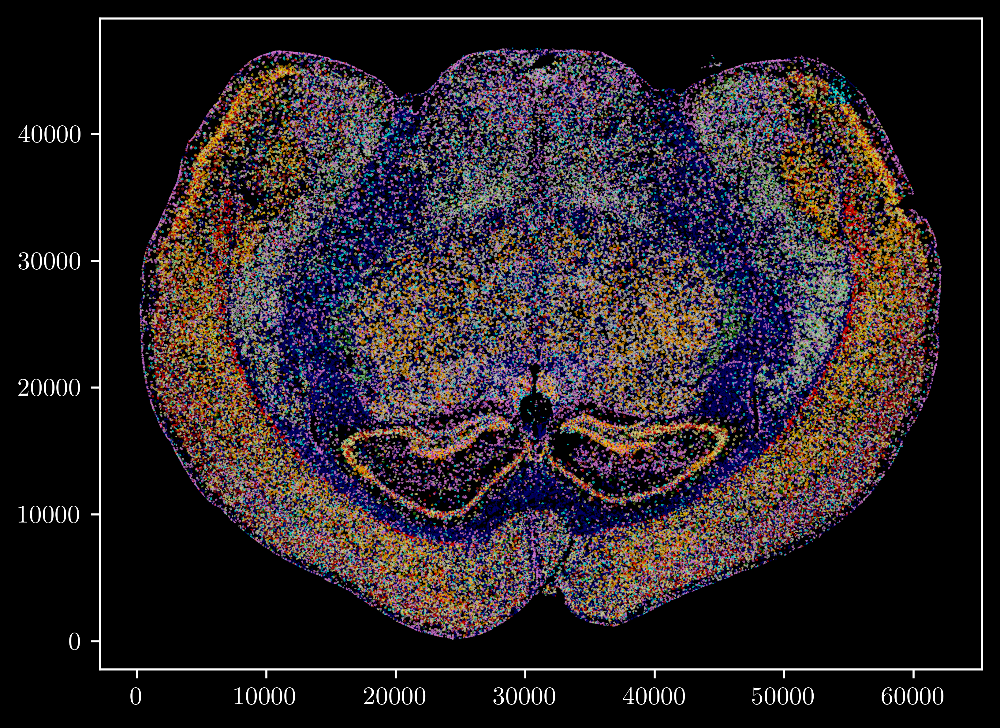

In [3]:
# 5 types for whole brain
from scipy.spatial import ConvexHull
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import ListedColormap
from scipy.interpolate import splprep
from scipy.interpolate import splev
from scipy.spatial.qhull import QhullError
matplotlib.rcParams.update({
"pgf.texsystem": "xelatex",
'font.family': 'serif',
'text.usetex': True,
'pgf.rcfonts': False,
'figure.dpi': 600,
})
df = pd.read_csv(visual_dir/'rna_labeled.csv')
hulls = {}
x = 0.5
df_group = df.groupby('Cell Index')
for group in df_group:
    coordinates = group[1][['Y', 'X']].values   
    try:
        hull = ConvexHull(coordinates)
        coordinate_path = np.vstack((coordinates[hull.vertices,0], coordinates[hull.vertices,1])).T
        hulls[group[0]] = coordinate_path
    except QhullError:
        pass
#fig = plt.figure(figsize=(6,4))
fig,ax = plt.subplots(figsize=(6.2,4.7))
#for idx in hulls:
  #  ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "lightgray", linewidth=0.5)
for idx in type_indices[17]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "lightgray", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[15]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "cyan", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[6]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "khaki", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[1]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "darkred", linewidth=0.3, alpha=x) #darkred
    except KeyError:
        pass
for idx in type_indices[2]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "firebrick", linewidth=0.3, alpha=x) #firebrick
    except KeyError:
        pass
for idx in type_indices[3]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "orange", linewidth=0.3, alpha=x) #orange
    except KeyError:
        pass
for idx in type_indices[4]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "gold", linewidth=0.3, alpha=x) #gold
    except KeyError:
        pass
for idx in type_indices[5]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "red", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[13]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "lightgreen", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[7]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "olive", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[8]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "olivedrab", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[9]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "darkseagreen", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[10]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "green", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[11]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "darkgreen", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[12]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "forestgreen", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[16]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "navy", linewidth=0.3, alpha=x)
    except KeyError:
        pass
for idx in type_indices[14]:
    try:
        ax.fill(hulls[idx][:,1], hulls[idx][:,0], color = "violet", linewidth=0.3, alpha=x)
    except KeyError:
        pass
plt.savefig(visual_dir/'rna_hulls_whole_brain_17types_color_3.jpg')
#plt.show()

In [5]:
for key in type_indices:
    print(len(type_indices[key]))

0
40753
6178
76560


In [ ]:
factor[factor['Type Factor']==1]

In [ ]:
s = 0
for t in type_indices:
    s += len(type_indices[t])
print(s)
print(len(hulls))

In [ ]:
test_df = factor[factor['Cell_Index'].isin(np.array(type_indices[5]))]
test_df.to_csv(visual_dir/'Nr4a2_cluster_exp.csv', index=False)

In [ ]:
print(type_indices[0])

In [ ]:
print(len(np.unique(factor['Cell_Index'])))

In [ ]:
factor.sample(n=150)

In [ ]:
#Normal_2
type_indices = {}
for type in range(len(np.unique(factor['type']))):
    type_indices[type] = factor[factor['type']==type]['Cell_Index']

factor = pd.read_csv(visual_dir/'select_matrix.csv')
Type_1 = list(factor[0:236].Cell_Index)
Type_2 = list(factor[237:294].Cell_Index)
Type_3 = list(factor[295:780].Cell_Index)
Type_4 = list(factor[781:1102].Cell_Index)
Type_5 = list(factor[1103:1486].Cell_Index)
Type_6 = list(factor[1487:1548].Cell_Index)
Type_7 = list(factor[1549:1634].Cell_Index)
Type_8 = list(factor[1635:1792].Cell_Index)


In [ ]:
#Normal_2_big
factor = pd.read_csv(visual_dir/'select_matrix.csv')
Type_1 = list(factor[0:272].Cell_Index)
Type_2 = list(factor[273:507].Cell_Index)
Type_3 = list(factor[508:803].Cell_Index)
Type_4 = list(factor[804:1015].Cell_Index)
Type_5 = list(factor[1016:1401].Cell_Index)
Type_6 = list(factor[1402:1563].Cell_Index)
Type_7 = list(factor[1564:1778].Cell_Index)
#Type_8 = list(factor[1635:1792].Cell_Index)

In [ ]:
#AD_2
factor = pd.read_csv(visual_dir/'select_matrix.csv')
Type_1 = list(factor[0:610].Cell_Index)
Type_2 = list(factor[611:773].Cell_Index)
Type_3 = list(factor[774:827].Cell_Index)
Type_4 = list(factor[828:1152].Cell_Index)
Type_5 = list(factor[1153:1372].Cell_Index)
Type_6 = list(factor[1373:1561].Cell_Index)
#Type_7 = list(factor[1549:1634].Cell_Index)
#Type_8 = list(factor[1635:1792].Cell_Index)

In [ ]:
#AD_1
factor = pd.read_csv(visual_dir/'select_matrix.csv')
Type_1 = list(factor[0:803].Cell_Index)
Type_2 = list(factor[804:1062].Cell_Index)
Type_3 = list(factor[1063:1543].Cell_Index)
#Type_4 = list(factor[2122:2276].Cell_Index)
Type_5 = list(factor[1544:1780].Cell_Index)
Type_6 = list(factor[1781:1897].Cell_Index)

In [ ]:
#Normal_1
factor = pd.read_csv(visual_dir/'select_matrix.csv')
Type_1 = list(factor[0:743].Cell_Index)
Type_2 = list(factor[744:901].Cell_Index)
Type_3 = list(factor[902:1438].Cell_Index)
#Type_4 = list(factor[2199:2276].Cell_Index)
Type_5 = list(factor[1439:1801].Cell_Index)
Type_6 = list(factor[1802:1890].Cell_Index)

In [ ]:
from scipy.interpolate import splprep
from scipy.interpolate import splev
fig = plt.figure(figsize=(20,5))
for idx in hulls:
    coordinate_path = hulls[idx]
    tck, u = splprep(coordinate_path.T, s=0.0, u=None, per=1)
    u_new = np.linspace(u.min(), u.max(), 100)
    x_new, y_new = splev(u_new, tck, der=0)
    plt.fill(x_new, y_new, color = "Blue", linewidth=0.5)
plt.savefig('rna_hulls_interpolated.pdf')
plt.show()

In [ ]:
def brain_layer(x, threshold=3):
    if x['Rasgrf2'] > 1.3*threshold:
        return 'Layer 2 or 3'
    elif x['Plcxd2'] > 2*threshold:
        return 'Layer 4'
    elif x['Rab3c'] > 0.5*threshold:
        return 'Layer 5'
    elif x['Ctgf'] > 1.5*threshold:
        return 'Layer 6b'
    elif x['Pcp4'] > 3*threshold:
        return 'Layer 6a'
    elif x['Mbp'] > 3*threshold:
        return 'cc'
    else:
        return 'Other'
matrix['Brain Layer'] = matrix.apply(brain_layer, axis=1)
factor_dict = {
    'Layer 2 or 3': 1,
    'Layer 4': 2,
    'Layer 5': 3,
    'Layer 6a': 4,
    'Layer 6b': 5,
    'cc': 6,
    'Other': 7
}
matrix['Layer Factor'] = matrix['Brain Layer'].map(factor_dict)
factors = matrix['Layer Factor']
centroids = cell_pos[['Y','X']].to_numpy()
factors.index = segmented[centroids[:,0],centroids[:,1]]
factor_dict = factors.to_dict()
im_factor = (replace_with_dict_generic(segmented,factor_dict,assume_all_present=False))
im_factor[im_factor>7] = 7
data = im_factor.copy()
values = np.unique(data.ravel())
#cmap = ListedColormap(['white','lightcoral','lemonchiffon','palegreen','lightblue','violet','lightgray'])
cmap = ListedColormap(['white','red','orange','green','cyan','blue','purple','lightgray'])
labels = ['Background','Layer 2 or 3','Layer 4','Layer 5','Layer 6a','Layer 6b','cc','Other']
plt.figure(figsize=(8,4))
im = plt.imshow(data, interpolation='none',cmap=cmap)
colors = [im.cmap(im.norm(value)) for value in values]
patches = [ mpatches.Patch(color=colors[i], label=labels[i] ) for i in range(len(values)) ]
plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0. )
plt.axis('off')
plt.savefig(visual_dir/'layer_remap.pdf', bbox_inches='tight')
plt.show()

In [ ]:
select_matrix['Type'] = normalized['Type']
sns.boxplot(data=select_matrix, x='Type', y='Snap25', fliersize=0.4)
plt.savefig(visual_dir/'box_Snap25.pdf')
plt.show()